In [1]:
import os
import glob
import time
import imageio
import numpy as np
import tensorflow as tf
from tensorflow.keras import layers
import matplotlib.pyplot as plt
from IPython.display import Image, display, clear_output
import matplotlib.image as mpimg
%matplotlib inline

import warnings
warnings.filterwarnings('ignore')  # 경고 메시지 무시

# ✅ Google Drive 마운트
from google.colab import drive
drive.mount('/content/drive')

# ✅ Colab 경로 설정 (Google Drive에 저장)
base_dir = "/content/drive/MyDrive/DCGAN_CIFAR10"

sample_dir = os.path.join(base_dir, "generated_samples_ver3")
history_dir = os.path.join(base_dir, "training_history_ver3")
checkpoint_dir = os.path.join(base_dir, "training_checkpoints_ver3")

os.makedirs(sample_dir, exist_ok=True)
os.makedirs(history_dir, exist_ok=True)
os.makedirs(checkpoint_dir, exist_ok=True)

# ✅ Hyperparameters
BUFFER_SIZE = 50000
BATCH_SIZE = 256
noise_dim = 100
num_examples_to_generate = 16
EPOCHS = 50
save_every = 5

# ✅ 데이터셋 로드 및 정규화
(train_x, _), (_, _) = tf.keras.datasets.cifar10.load_data()
train_x = (train_x - 127.5) / 127.5
train_dataset = tf.data.Dataset.from_tensor_slices(train_x).shuffle(BUFFER_SIZE).batch(BATCH_SIZE)

print("✅ 데이터셋 준비 완료!")

Mounted at /content/drive
170498071/170498071 ━━━━━━━━━━━━━━━━━━━━ 10s 0us/step
✅ 데이터셋 준비 완료!


In [2]:
# 모델 정의

# Generator with Virtual Batch Normalization
def make_generator_model():
    # Start
    model = tf.keras.Sequential([

        # First: Dense layer
        layers.Dense(8*8*256, use_bias=False, input_shape=(100,)),
        layers.BatchNormalization(),
        layers.LeakyReLU(),

        # Second: Reshape layer
        layers.Reshape((8, 8, 256)),

        # Third: Conv2DTranspose layer
        layers.Conv2DTranspose(128, (5, 5), strides=(2, 2), padding='same', use_bias=False),
        layers.BatchNormalization(),
        layers.LeakyReLU(),

        # Fourth: Conv2DTranspose layer
        layers.Conv2DTranspose(64, (5, 5), strides=(2, 2), padding='same', use_bias=False),
        layers.BatchNormalization(),
        layers.LeakyReLU(),

        # Fifth: Conv2DTranspose layer
        layers.Conv2DTranspose(3, (5, 5), strides=(1, 1), padding='same', use_bias=False, activation='tanh')
    ])
    return model

generator = make_generator_model()

generator.summary()

Model: "sequential"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ dense (Dense)                        │ (None, 16384)               │       1,638,400 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization                  │ (None, 16384)               │          65,536 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ leaky_re_lu (LeakyReLU)              │ (None, 16384)               │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ reshape (Reshape)                    │ (None, 8, 8, 256)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_transpose (Conv2DTranspose)   │ (None, 16, 16, 128)         │         819,200 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_1                │ (None, 16, 16, 128)         │             512 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ leaky_re_lu_1 (LeakyReLU)            │ (None, 16, 16, 128)         │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_transpose_1 (Conv2DTranspose) │ (None, 32, 32, 64)          │         204,800 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ batch_normalization_2                │ (None, 32, 32, 64)          │             256 │
│ (BatchNormalization)                 │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ leaky_re_lu_2 (LeakyReLU)            │ (None, 32, 32, 64)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_transpose_2 (Conv2DTranspose) │ (None, 32, 32, 3)           │           4,800 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 2,733,504 (10.43 MB)

 Trainable params: 2,700,352 (10.30 MB)

 Non-trainable params: 33,152 (129.50 KB)

In [3]:
from tensorflow.keras import layers, initializers

class MinibatchDiscrimination(layers.Layer):
    def __init__(self, num_kernels, kernel_dim, **kwargs):
        super(MinibatchDiscrimination, self).__init__(**kwargs)
        self.num_kernels = num_kernels
        self.kernel_dim = kernel_dim

    def build(self, input_shape):
        # 논문에 따라 A×B×C 형태의 T 텐서 생성
        self.T = self.add_weight(
            name='kernel',
            shape=(input_shape[1], self.num_kernels, self.kernel_dim),
            initializer=initializers.RandomNormal(stddev=0.02),
            trainable=True
        )

    def call(self, inputs):
        # 1. 입력 벡터에 T 텐서 곱하기 → (batch_size, num_kernels, kernel_dim)
        M = tf.tensordot(inputs, self.T, axes=1)

        # 2. 샘플 간 L1 Distance 계산
        M_expanded1 = tf.expand_dims(M, 3)  # (batch_size, num_kernels, kernel_dim, 1)
        M_expanded2 = tf.expand_dims(tf.transpose(M, [1, 2, 0]), 0)  # (1, num_kernels, kernel_dim, batch_size)

        # 3. L1 거리 계산 → (batch_size, num_kernels, batch_size)
        abs_diffs = tf.reduce_sum(tf.abs(M_expanded1 - M_expanded2), axis=2)

        # 4. Negative exponential 적용 → (batch_size, num_kernels, batch_size)
        c = tf.exp(-abs_diffs)

        # 5. Minibatch feature 생성 (다른 샘플과의 유사성 총합)
        o = tf.reduce_sum(c, axis=2)

        # 6. 원본 입력 벡터와 Minibatch feature를 결합
        return tf.concat([inputs, o], axis=1)

# Discriminator with Minibatch Discrimination + Feature Matching
def make_discriminator_model():
    inputs = layers.Input(shape=(32, 32, 3))

    # First Conv Layer
    x = layers.Conv2D(64, (5, 5), strides=(2, 2), padding='same')(inputs)
    x = layers.LeakyReLU()(x)
    x = layers.Dropout(0.3)(x)

    # Second Conv Layer
    x = layers.Conv2D(128, (5, 5), strides=(2, 2), padding='same')(x)
    x = layers.LeakyReLU()(x)
    x = layers.Dropout(0.3)(x)

    # Flatten
    x_flat = layers.Flatten()(x)

    # Minibatch Discrimination
    x_mbd = MinibatchDiscrimination(num_kernels=50, kernel_dim=5)(x_flat)

    # Output layer
    outputs = layers.Dense(1)(x_mbd)

    # Feature extraction model (for Feature Matching)
    feature_extractor = tf.keras.Model(inputs, x_flat)

    # Final discriminator model
    model = tf.keras.Model(inputs, outputs)

    return model, feature_extractor

# 모델 생성
discriminator, feature_extractor = make_discriminator_model()
discriminator.summary()
feature_extractor.summary()

Model: "functional_2"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer_1 (InputLayer)           │ (None, 32, 32, 3)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d (Conv2D)                      │ (None, 16, 16, 64)          │           4,864 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ leaky_re_lu_3 (LeakyReLU)            │ (None, 16, 16, 64)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout (Dropout)                    │ (None, 16, 16, 64)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_1 (Conv2D)                    │ (None, 8, 8, 128)           │         204,928 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ leaky_re_lu_4 (LeakyReLU)            │ (None, 8, 8, 128)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_1 (Dropout)                  │ (None, 8, 8, 128)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten (Flatten)                    │ (None, 8192)                │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ minibatch_discrimination             │ (None, 8242)                │       2,048,000 │
│ (MinibatchDiscrimination)            │                             │                 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dense_1 (Dense)                      │ (None, 1)                   │           8,243 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 2,266,035 (8.64 MB)

 Trainable params: 2,266,035 (8.64 MB)

 Non-trainable params: 0 (0.00 B)

Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━┓
┃ Layer (type)                         ┃ Output Shape                ┃         Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━┩
│ input_layer_1 (InputLayer)           │ (None, 32, 32, 3)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d (Conv2D)                      │ (None, 16, 16, 64)          │           4,864 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ leaky_re_lu_3 (LeakyReLU)            │ (None, 16, 16, 64)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout (Dropout)                    │ (None, 16, 16, 64)          │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ conv2d_1 (Conv2D)                    │ (None, 8, 8, 128)           │         204,928 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ leaky_re_lu_4 (LeakyReLU)            │ (None, 8, 8, 128)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ dropout_1 (Dropout)                  │ (None, 8, 8, 128)           │               0 │
├──────────────────────────────────────┼─────────────────────────────┼─────────────────┤
│ flatten (Flatten)                    │ (None, 8192)                │               0 │
└──────────────────────────────────────┴─────────────────────────────┴─────────────────┘

 Total params: 209,792 (819.50 KB)

 Trainable params: 209,792 (819.50 KB)

 Non-trainable params: 0 (0.00 B)

In [4]:
# Loss & Optimizer with One-sided Label Smoothing

# 손실 함수 정의
cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits=True)

# 생성자의 손실 함수
def generator_loss(fake_output):
    return cross_entropy(tf.ones_like(fake_output), fake_output)

# 판별자의 손실 함수
def discriminator_loss(real_output, fake_output):
    real_loss = cross_entropy(tf.ones_like(real_output) * 0.9, real_output)
    fake_loss = cross_entropy(tf.zeros_like(fake_output), fake_output)
    return real_loss + fake_loss

# Feature Matching Loss 정의
def feature_matching_loss(real_features, fake_features):
    return tf.reduce_mean(tf.square(tf.reduce_mean(real_features, axis=0) - tf.reduce_mean(fake_features, axis=0)))

# 판별자의 정확도(accuracy) 계산 함수
def discriminator_accuracy(real_output, fake_output):
    real_accuracy = tf.reduce_mean(tf.cast(real_output > 0.5, tf.float32))
    fake_accuracy = tf.reduce_mean(tf.cast(fake_output < 0.5, tf.float32))
    return real_accuracy, fake_accuracy

generator_optimizer = tf.keras.optimizers.Adam(1e-4, beta_1=0.5)
discriminator_optimizer = tf.keras.optimizers.Adam(1e-4, beta_1=0.5)

# Checkpoint 설정
checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
checkpoint = tf.train.Checkpoint(generator_optimizer=generator_optimizer,
                                 discriminator_optimizer=discriminator_optimizer,
                                 generator=generator,
                                 discriminator=discriminator)

In [5]:
# Training Step
@tf.function
def train_step(images):
    noise = tf.random.normal([BATCH_SIZE, noise_dim])

    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
        # 1. 이미지 생성
        generated_images = generator(noise, training=True)

        # 2. 판별자 출력
        real_output = discriminator(images, training=True)
        fake_output = discriminator(generated_images, training=True)

        # 3. 중간 Feature 추출 (Feature Matching용)
        real_features = feature_extractor(images, training=True)
        fake_features = feature_extractor(generated_images, training=True)

        # 4. 기존 손실 계산
        gen_loss = generator_loss(fake_output)

        # 5. Feature Matching 손실 추가
        fm_loss = feature_matching_loss(real_features, fake_features)
        total_gen_loss = gen_loss + fm_loss  # 기존 손실 + Feature Matching 손실

        disc_loss = discriminator_loss(real_output, fake_output)

        # 6. 정확도 계산 (0.5 기준으로 판단)
        real_accuracy, fake_accuracy = discriminator_accuracy(real_output, fake_output)

    # 7. Gradient 업데이트
    gradients_of_generator = gen_tape.gradient(total_gen_loss, generator.trainable_variables)
    gradients_of_discriminator = disc_tape.gradient(disc_loss, discriminator.trainable_variables)

    generator_optimizer.apply_gradients(zip(gradients_of_generator, generator.trainable_variables))
    discriminator_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminator.trainable_variables))

    return total_gen_loss, disc_loss, real_accuracy, fake_accuracy

In [11]:
# Training & Saving Process

from matplotlib.pylab import rcParams
rcParams['figure.figsize'] = 15, 6 # matlab 차트 크기를 15,6으로 지정

# 학습 진행 그래프 저장
def draw_train_history(history, epoch):
    fig, axs = plt.subplots(2, 1)

    # summarize history for loss
    plt.subplot(211)
    plt.plot(history['gen_loss'])
    plt.plot(history['disc_loss'])
    plt.title('model loss')
    plt.ylabel('loss')
    plt.xlabel('batch iters')
    plt.legend(['gen_loss', 'disc_loss'], loc='upper left')

    # summarize history for accuracy
    plt.subplot(212)
    plt.plot(history['fake_accuracy'])
    plt.plot(history['real_accuracy'])
    plt.title('discriminator accuracy')
    plt.ylabel('accuracy')
    plt.xlabel('batch iters')
    plt.legend(['fake_accuracy', 'real_accuracy'], loc='upper left')

    # epoch별 그래프를 이미지 파일로 저장
    save_path = os.path.join(history_dir, f'train_history_{epoch:04d}.png')
    plt.savefig(save_path)
    plt.close(fig)

# 랜덤 노이즈 시드 생성 (샘플 이미지 저장용)
seed = tf.random.normal([num_examples_to_generate, noise_dim])

# 샘플 이미지 생성 및 저장 함수
def generate_and_save_images(model, epoch, it, sample_seeds):
    predictions = model(sample_seeds, training=False)

    fig = plt.figure(figsize=(4, 4))
    for i in range(predictions.shape[0]):
        plt.subplot(4, 4, i+1)
        plt.imshow((predictions[i] * 127.5 + 127.5).numpy().astype(np.uint8))
        plt.axis('off')

    # 이미지 저장 경로
    save_path = os.path.join(sample_dir, f'sample_epoch_{epoch:04d}_iter_{it:03d}.png')
    plt.savefig(save_path)
    plt.close(fig)

In [12]:
# 디렉토리 생성 (학습 전 실행 필요!)
os.makedirs(sample_dir, exist_ok=True)
os.makedirs(history_dir, exist_ok=True)
os.makedirs(checkpoint_dir, exist_ok=True)

In [18]:
# Training Function
def train(dataset, epochs, save_every):
    start = time.time()
    history = {'gen_loss':[], 'disc_loss':[], 'real_accuracy':[], 'fake_accuracy':[]}

    for epoch in range(epochs):
        epoch_start = time.time()
        for it, image_batch in enumerate(dataset):
            gen_loss, disc_loss, real_accuracy, fake_accuracy = train_step(image_batch)
            history['gen_loss'].append(gen_loss)
            history['disc_loss'].append(disc_loss)
            history['real_accuracy'].append(real_accuracy)
            history['fake_accuracy'].append(fake_accuracy)

            if it % 50 == 0:
                clear_output(wait=True)
                generate_and_save_images(generator, epoch+1, it+1, seed)
                print('Epoch {} | iter {}'.format(epoch+1, it+1))
                print('Time for epoch {} : {} sec'.format(epoch+1, int(time.time()-epoch_start)))

        if (epoch + 1) % save_every == 0:
            checkpoint.save(file_prefix=checkpoint_prefix)

        clear_output(wait=True)
        generate_and_save_images(generator, epochs, it, seed)
        print('Time for training : {} sec'.format(int(time.time()-start)))

        draw_train_history(history, epoch)

# 학습 실행
train(train_dataset, EPOCHS, save_every)

Time for training : 1498 sec


In [19]:
def save_gif(image_folder, output_gif_path, duration=0.1):
    # 이미지 파일 경로 가져오기
    image_files = sorted(glob.glob(os.path.join(image_folder, '*.png')))

    # GIF로 저장
    with imageio.get_writer(output_gif_path, mode='I', duration=duration) as writer:
        for filename in image_files:
            image = imageio.imread(filename)
            writer.append_data(image)

    print(f"GIF saved at: {output_gif_path}")

GIF saved at: /content/drive/MyDrive/DCGAN_CIFAR10/generated_samples_ver3/cifar10_samples_ver3.gif


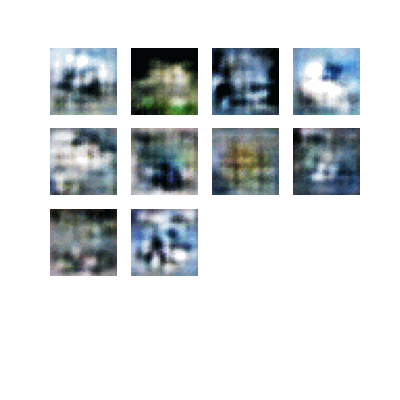

In [20]:
# 샘플 이미지 저장 및 GIF 생성
sample_gif_path = os.path.join(sample_dir, 'cifar10_samples_ver3.gif')
save_gif(sample_dir, sample_gif_path, duration=0.1)

# 결과 표시
display(Image(filename=sample_gif_path))

GIF saved at: /content/drive/MyDrive/DCGAN_CIFAR10/training_history_ver3/training_history_ver3.gif


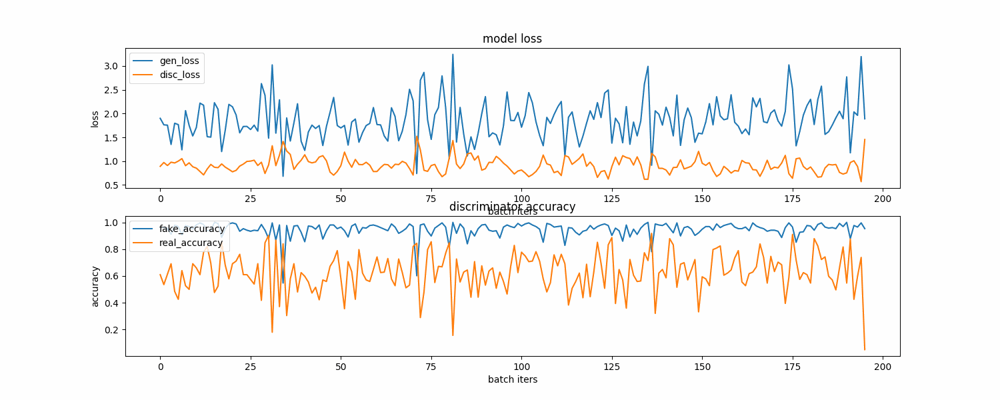

In [21]:
# 학습 그래프 저장 및 GIF 생성
history_gif_path = os.path.join(history_dir, 'training_history_ver3.gif')
save_gif(history_dir, history_gif_path, duration=0.1)

# 결과 표시
display(Image(filename=history_gif_path))

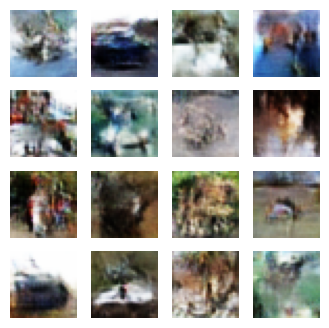

✅ Training Completed! Total Time: 1512 sec


In [22]:
import os
import glob
import time
import imageio
import numpy as np
import tensorflow as tf
from tensorflow.keras import layers
import matplotlib.pyplot as plt
from IPython.display import Image, display, clear_output
import matplotlib.image as mpimg

import warnings
warnings.filterwarnings('ignore')  # 경고 메시지 무시

# ✅ Google Drive 마운트
from google.colab import drive
drive.mount('/content/drive')

# ✅ Colab 경로 설정 (Google Drive에 저장)
base_dir = "/content/drive/MyDrive/DCGAN_CIFAR10"

sample_dir = os.path.join(base_dir, "generated_samples_ver4")
history_dir = os.path.join(base_dir, "training_history_ver4")
checkpoint_dir = os.path.join(base_dir, "training_checkpoints_ver4")

os.makedirs(sample_dir, exist_ok=True)
os.makedirs(history_dir, exist_ok=True)
os.makedirs(checkpoint_dir, exist_ok=True)

# ✅ Hyperparameters
BUFFER_SIZE = 50000
BATCH_SIZE = 256
noise_dim = 100
num_examples_to_generate = 16  # 16개 이미지 출력
EPOCHS = 50  # 추가 학습을 위해 50부터 100까지 돌릴 예정
save_every = 5

# ✅ 데이터셋 로드 및 정규화
(train_x, _), (_, _) = tf.keras.datasets.cifar10.load_data()
train_x = (train_x - 127.5) / 127.5
train_dataset = tf.data.Dataset.from_tensor_slices(train_x).shuffle(BUFFER_SIZE).batch(BATCH_SIZE)

print("✅ 데이터셋 준비 완료!")

# ✅ 체크포인트 로드 (이전 학습한 50번까지의 가중치 불러오기)
checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
checkpoint = tf.train.Checkpoint(generator_optimizer=generator_optimizer,
                                 discriminator_optimizer=discriminator_optimizer,
                                 generator=generator,
                                 discriminator=discriminator)
checkpoint.restore(tf.train.latest_checkpoint(checkpoint_dir))
print("✅ 체크포인트에서 모델 불러오기 완료!")

# ✅ 랜덤 노이즈 시드 생성 (샘플 이미지 저장용)
seed = tf.random.normal([num_examples_to_generate, noise_dim])

# ✅ 샘플 이미지 생성 및 저장 함수 (16개 이미지 출력)
def generate_and_save_images(model, epoch, it, sample_seeds):
    predictions = model(sample_seeds, training=False)

    fig = plt.figure(figsize=(4, 4))
    for i in range(predictions.shape[0]):
        plt.subplot(4, 4, i+1)
        plt.imshow((predictions[i] * 127.5 + 127.5).numpy().astype(np.uint8))
        plt.axis('off')

    # 이미지 저장 경로
    save_path = os.path.join(sample_dir, f'sample_epoch_{epoch:04d}_iter_{it:03d}.png')
    plt.savefig(save_path)
    plt.show()  # 화면에 출력
    plt.close(fig)

# ✅ 학습 진행 그래프 저장 함수
def draw_train_history(history, epoch):
    fig, axs = plt.subplots(2, 1, figsize=(10, 6))

    # summarize history for loss
    axs[0].plot(history['gen_loss'], label='gen_loss')
    axs[0].plot(history['disc_loss'], label='disc_loss')
    axs[0].set_title('Model Loss')
    axs[0].set_ylabel('Loss')
    axs[0].set_xlabel('Batch Iterations')
    axs[0].legend(loc='upper right')

    # summarize history for accuracy
    axs[1].plot(history['fake_accuracy'], label='fake_accuracy')
    axs[1].plot(history['real_accuracy'], label='real_accuracy')
    axs[1].set_title('Discriminator Accuracy')
    axs[1].set_ylabel('Accuracy')
    axs[1].set_xlabel('Batch Iterations')
    axs[1].legend(loc='upper right')

    # 그래프 저장 및 출력
    save_path = os.path.join(history_dir, f'train_history_{epoch:04d}.png')
    plt.savefig(save_path)
    plt.show()  # 화면에 출력
    plt.close(fig)

# ✅ Training Function (50부터 100까지 학습)
def train(dataset, start_epoch, epochs, save_every):
    start = time.time()
    history = {'gen_loss':[], 'disc_loss':[], 'real_accuracy':[], 'fake_accuracy':[]}

    for epoch in range(start_epoch, epochs):
        epoch_start = time.time()
        for it, image_batch in enumerate(dataset):
            gen_loss, disc_loss, real_accuracy, fake_accuracy = train_step(image_batch)
            history['gen_loss'].append(gen_loss)
            history['disc_loss'].append(disc_loss)
            history['real_accuracy'].append(real_accuracy)
            history['fake_accuracy'].append(fake_accuracy)

            # 50번마다 샘플 이미지 16개씩 출력
            if it % 50 == 0:
                clear_output(wait=True)
                generate_and_save_images(generator, epoch+1, it+1, seed)
                print(f'🔄 Epoch {epoch+1} | Iteration {it+1}')
                print(f'⏳ Time for epoch {epoch+1}: {int(time.time()-epoch_start)} sec')

        if (epoch + 1) % save_every == 0:
            checkpoint.save(file_prefix=checkpoint_prefix)

        # 마지막 epoch에는 손실 그래프도 함께 출력
        if epoch == epochs - 1:
            draw_train_history(history, epoch)

    clear_output(wait=True)
    generate_and_save_images(generator, epochs, it, seed)  # 마지막 에폭 이미지 출력
    print(f'✅ Training Completed! Total Time: {int(time.time()-start)} sec')

# ✅ 추가 학습 실행 (50부터 100까지)
train(train_dataset, start_epoch=50, epochs=100, save_every=5)

🎥 GIF saved at: /content/drive/MyDrive/DCGAN_CIFAR10/generated_samples_ver4/cifar10_samples_epoch_50_to_100.gif
🎥 GIF saved at: /content/drive/MyDrive/DCGAN_CIFAR10/training_history_ver4/training_history_epoch_50_to_100.gif


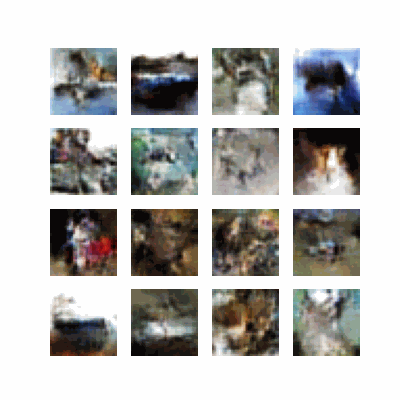

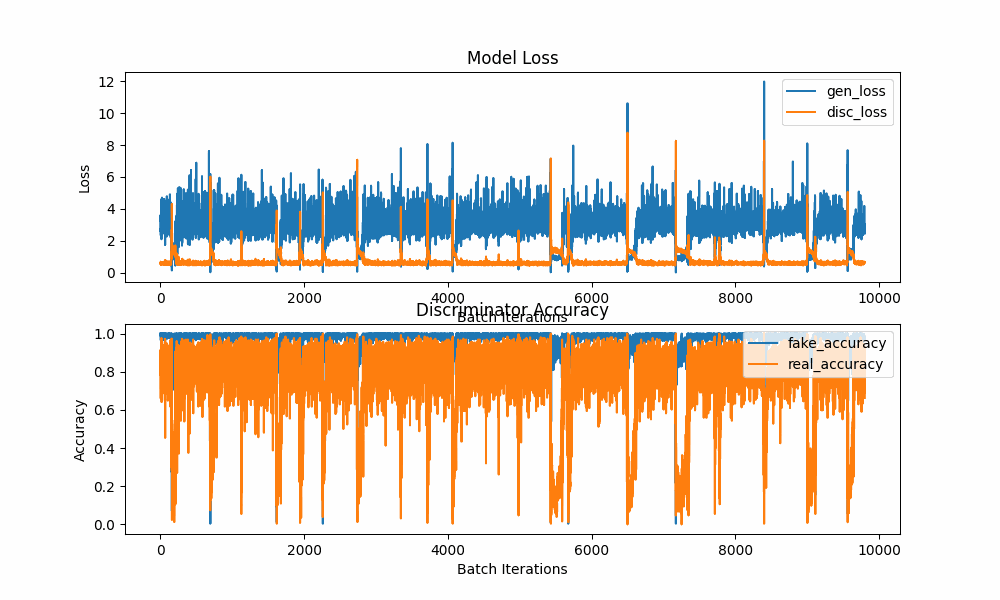

In [23]:
import os
import glob
import imageio
from IPython.display import Image, display

# ✅ GIF 저장 함수 (이미지들을 합쳐 GIF 생성)
def save_gif(image_folder, output_gif_path, duration=0.1):
    # 이미지 파일 경로 가져오기
    image_files = sorted(glob.glob(os.path.join(image_folder, '*.png')))

    # GIF로 저장
    with imageio.get_writer(output_gif_path, mode='I', duration=duration) as writer:
        for filename in image_files:
            image = imageio.imread(filename)
            writer.append_data(image)

    print(f"🎥 GIF saved at: {output_gif_path}")

# ✅ 샘플 이미지 GIF 저장 및 출력
sample_gif_path = os.path.join(sample_dir, 'cifar10_samples_epoch_50_to_100.gif')
save_gif(sample_dir, sample_gif_path, duration=0.1)

# ✅ 학습 그래프 GIF 저장 및 출력
history_gif_path = os.path.join(history_dir, 'training_history_epoch_50_to_100.gif')
save_gif(history_dir, history_gif_path, duration=0.1)

# ✅ 결과 표시 (생성된 샘플 이미지 GIF)
display(Image(filename=sample_gif_path))

# ✅ 결과 표시 (학습 그래프 GIF)
display(Image(filename=history_gif_path))